In [2]:
import torch
import json
import h5py
import numpy as np
from matplotlib.pyplot import imshow
from PIL import Image, ImageDraw

In [6]:
! ls /root/Scene/datasets/vg/VG-SGG-dicts-with-attri.json

/root/Scene/datasets/vg/VG-SGG-dicts-with-attri.json


In [8]:
image_file = json.load(open('/root/Scene/datasets/vg/image_data.json'))
vocab_file = json.load(open('/root/Scene/datasets/vg/VG-SGG-dicts-with-attri.json')) # VG-SGG-dicts.json
data_file = h5py.File('/root/Scene/datasets/vg/VG-SGG-with-attri.h5', 'r') # VG-SGG.h5
# remove invalid image
corrupted_ims = [1592, 1722, 4616, 4617]
tmp = []
for item in image_file:
    if int(item['image_id']) not in corrupted_ims:
        tmp.append(item)
image_file = tmp

In [9]:
# load detected results
detected_origin_path = '/root/Scene/checkpoint/motif-precls-exmp/inference/VG_stanford_filtered_with_attribute_test/'
detected_origin_result = torch.load(detected_origin_path + 'eval_results.pytorch')
detected_info = json.load(open(detected_origin_path + 'visual_info.json'))

In [10]:
# get image info by index
def get_info_by_idx(idx, det_input, thres=0.5):
    groundtruth = det_input['groundtruths'][idx]
    prediction = det_input['predictions'][idx]
    # image path
    img_path = detected_info[idx]['img_file']
    # boxes
    boxes = groundtruth.bbox
    # object labels
    idx2label = vocab_file['idx_to_label']
    labels = ['{}-{}'.format(idx,idx2label[str(i)]) for idx, i in enumerate(groundtruth.get_field('labels').tolist())]
    pred_labels = ['{}-{}'.format(idx,idx2label[str(i)]) for idx, i in enumerate(prediction.get_field('pred_labels').tolist())]
    # groundtruth relation triplet
    idx2pred = vocab_file['idx_to_predicate']
    gt_rels = groundtruth.get_field('relation_tuple').tolist()
    gt_rels = [(labels[i[0]], idx2pred[str(i[2])], labels[i[1]]) for i in gt_rels]
    # prediction relation triplet
    pred_rel_pair = prediction.get_field('rel_pair_idxs').tolist()
    pred_rel_label = prediction.get_field('pred_rel_scores')
    pred_rel_label[:,0] = 0
    pred_rel_score, pred_rel_label = pred_rel_label.max(-1)
    #mask = pred_rel_score > thres
    #pred_rel_score = pred_rel_score[mask]
    #pred_rel_label = pred_rel_label[mask]
    pred_rels = [(pred_labels[i[0]], idx2pred[str(j)], pred_labels[i[1]]) for i, j in zip(pred_rel_pair, pred_rel_label.tolist())]
    return img_path, boxes, labels, gt_rels, pred_rels, pred_rel_score, pred_rel_label

In [11]:
def draw_single_box(pic, box, color='red', draw_info=None):
    draw = ImageDraw.Draw(pic)
    x1,y1,x2,y2 = int(box[0]), int(box[1]), int(box[2]), int(box[3])
    draw.rectangle(((x1, y1), (x2, y2)), outline=color)
    if draw_info:
        draw.rectangle(((x1, y1), (x1+50, y1+10)), fill=color)
        info = draw_info
        draw.text((x1, y1), info)

def print_list(name, input_list):
    for i, item in enumerate(input_list):
        print(name + ' ' + str(i) + ': ' + str(item))
    
def draw_image(img_path, boxes, labels, gt_rels, pred_rels, pred_rel_score, pred_rel_label, print_img=True):
    pic = Image.open(img_path)
    num_obj = boxes.shape[0]
    for i in range(num_obj):
        info = labels[i]
        draw_single_box(pic, boxes[i], draw_info=info)
    if print_img:
        display(pic)
    if print_img:
        print('*' * 50)
        print_list('gt_boxes', labels)
        print('*' * 50)
        print_list('gt_rels', gt_rels)
        print('*' * 50)
    print_list('pred_rels', pred_rels[:20])
    print('*' * 50)
    
    return None

In [12]:
def show_selected(idx_list):
    for select_idx in idx_list:
        print(select_idx)
        draw_image(*get_info_by_idx(select_idx, detected_origin_result))
        
def show_all(start_idx, length):
    for cand_idx in range(start_idx, start_idx+length):
        print(cand_idx)
        draw_image(*get_info_by_idx(cand_idx, detected_origin_result))

0


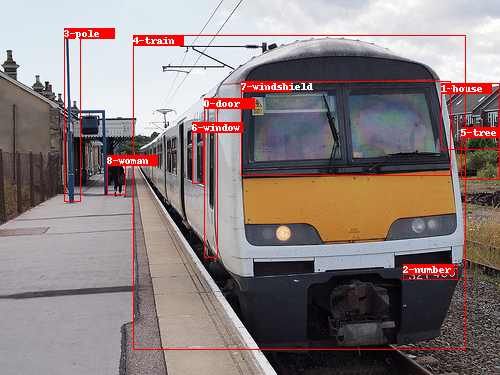

**************************************************
gt_boxes 0: 0-door
gt_boxes 1: 1-house
gt_boxes 2: 2-number
gt_boxes 3: 3-pole
gt_boxes 4: 4-train
gt_boxes 5: 5-tree
gt_boxes 6: 6-window
gt_boxes 7: 7-windshield
gt_boxes 8: 8-woman
**************************************************
gt_rels 0: ('7-windshield', 'on', '4-train')
gt_rels 1: ('6-window', 'on', '4-train')
gt_rels 2: ('4-train', 'has', '6-window')
gt_rels 3: ('1-house', 'near', '4-train')
gt_rels 4: ('5-tree', 'near', '1-house')
**************************************************
pred_rels 0: ('2-number', 'on', '4-train')
pred_rels 1: ('6-window', 'on', '4-train')
pred_rels 2: ('0-door', 'on', '4-train')
pred_rels 3: ('7-windshield', 'on', '4-train')
pred_rels 4: ('4-train', 'has', '7-windshield')
pred_rels 5: ('4-train', 'has', '0-door')
pred_rels 6: ('4-train', 'has', '2-number')
pred_rels 7: ('4-train', 'has', '6-window')
pred_rels 8: ('1-house', 'near', '4-train')
pred_rels 9: ('3-pole', 'near', '4-train')
pred_rels 10:

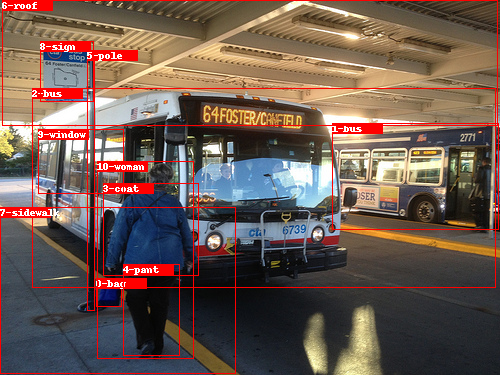

**************************************************
gt_boxes 0: 0-bag
gt_boxes 1: 1-bus
gt_boxes 2: 2-bus
gt_boxes 3: 3-coat
gt_boxes 4: 4-pant
gt_boxes 5: 5-pole
gt_boxes 6: 6-roof
gt_boxes 7: 7-sidewalk
gt_boxes 8: 8-sign
gt_boxes 9: 9-window
gt_boxes 10: 10-woman
**************************************************
gt_rels 0: ('2-bus', 'under', '6-roof')
gt_rels 1: ('10-woman', 'near', '2-bus')
gt_rels 2: ('9-window', 'on', '2-bus')
gt_rels 3: ('10-woman', 'wearing', '3-coat')
**************************************************
pred_rels 0: ('10-woman', 'wearing', '4-pant')
pred_rels 1: ('10-woman', 'wearing', '3-coat')
pred_rels 2: ('10-woman', 'on', '7-sidewalk')
pred_rels 3: ('8-sign', 'on', '5-pole')
pred_rels 4: ('9-window', 'on', '2-bus')
pred_rels 5: ('6-roof', 'above', '2-bus')
pred_rels 6: ('5-pole', 'on', '7-sidewalk')
pred_rels 7: ('0-bag', 'on', '7-sidewalk')
pred_rels 8: ('10-woman', 'has', '0-bag')
pred_rels 9: ('10-woman', 'in front of', '2-bus')
pred_rels 10: ('3-coat', 

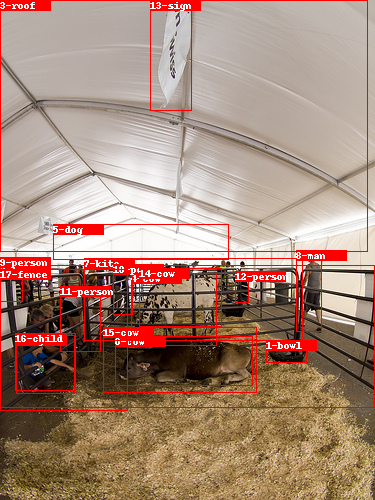

**************************************************
gt_boxes 0: 0-cow
gt_boxes 1: 1-bowl
gt_boxes 2: 2-boy
gt_boxes 3: 3-roof
gt_boxes 4: 4-cow
gt_boxes 5: 5-dog
gt_boxes 6: 6-fence
gt_boxes 7: 7-kite
gt_boxes 8: 8-man
gt_boxes 9: 9-person
gt_boxes 10: 10-person
gt_boxes 11: 11-person
gt_boxes 12: 12-person
gt_boxes 13: 13-sign
gt_boxes 14: 14-cow
gt_boxes 15: 15-cow
gt_boxes 16: 16-child
gt_boxes 17: 17-fence
**************************************************
gt_rels 0: ('13-sign', 'hanging from', '3-roof')
gt_rels 1: ('6-fence', 'near', '0-cow')
**************************************************
pred_rels 0: ('9-person', 'watching', '15-cow')
pred_rels 1: ('1-bowl', 'on', '6-fence')
pred_rels 2: ('9-person', 'behind', '17-fence')
pred_rels 3: ('14-cow', 'on', '7-kite')
pred_rels 4: ('4-cow', 'on', '7-kite')
pred_rels 5: ('9-person', 'watching', '0-cow')
pred_rels 6: ('17-fence', 'near', '15-cow')
pred_rels 7: ('10-person', 'holding', '7-kite')
pred_rels 8: ('12-person', 'holding', '7-

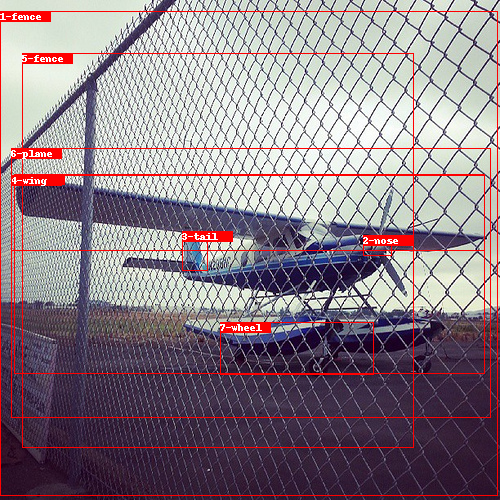

**************************************************
gt_boxes 0: 0-plane
gt_boxes 1: 1-fence
gt_boxes 2: 2-nose
gt_boxes 3: 3-tail
gt_boxes 4: 4-wing
gt_boxes 5: 5-fence
gt_boxes 6: 6-plane
gt_boxes 7: 7-wheel
**************************************************
gt_rels 0: ('4-wing', 'on', '6-plane')
gt_rels 1: ('0-plane', 'has', '3-tail')
gt_rels 2: ('1-fence', 'in front of', '0-plane')
gt_rels 3: ('7-wheel', 'on', '6-plane')
gt_rels 4: ('4-wing', 'on', '0-plane')
**************************************************
pred_rels 0: ('4-wing', 'of', '6-plane')
pred_rels 1: ('2-nose', 'of', '6-plane')
pred_rels 2: ('3-tail', 'of', '6-plane')
pred_rels 3: ('7-wheel', 'on', '6-plane')
pred_rels 4: ('6-plane', 'in', '1-fence')
pred_rels 5: ('4-wing', 'of', '0-plane')
pred_rels 6: ('4-wing', 'on', '1-fence')
pred_rels 7: ('6-plane', 'has', '4-wing')
pred_rels 8: ('2-nose', 'of', '0-plane')
pred_rels 9: ('3-tail', 'of', '0-plane')
pred_rels 10: ('0-plane', 'has', '4-wing')
pred_rels 11: ('6-plane', '

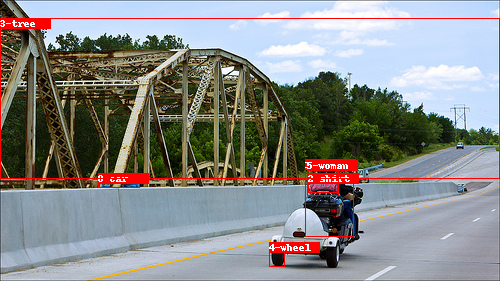

**************************************************
gt_boxes 0: 0-car
gt_boxes 1: 1-people
gt_boxes 2: 2-shirt
gt_boxes 3: 3-tree
gt_boxes 4: 4-wheel
gt_boxes 5: 5-woman
**************************************************
gt_rels 0: ('5-woman', 'wearing', '2-shirt')
gt_rels 1: ('5-woman', 'wearing', '2-shirt')
**************************************************
pred_rels 0: ('5-woman', 'wearing', '2-shirt')
pred_rels 1: ('1-people', 'wearing', '2-shirt')
pred_rels 2: ('2-shirt', 'on', '5-woman')
pred_rels 3: ('3-tree', 'behind', '1-people')
pred_rels 4: ('3-tree', 'behind', '5-woman')
pred_rels 5: ('0-car', 'near', '3-tree')
pred_rels 6: ('3-tree', 'near', '0-car')
pred_rels 7: ('5-woman', 'on', '1-people')
pred_rels 8: ('1-people', 'under', '3-tree')
pred_rels 9: ('4-wheel', 'of', '0-car')
pred_rels 10: ('2-shirt', 'on', '1-people')
pred_rels 11: ('1-people', 'has', '5-woman')
pred_rels 12: ('0-car', 'has', '4-wheel')
pred_rels 13: ('0-car', 'behind', '1-people')
pred_rels 14: ('1-people

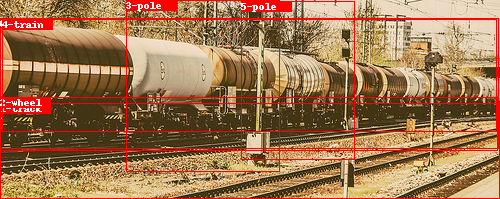

**************************************************
gt_boxes 0: 0-car
gt_boxes 1: 1-track
gt_boxes 2: 2-wheel
gt_boxes 3: 3-pole
gt_boxes 4: 4-train
gt_boxes 5: 5-pole
**************************************************
gt_rels 0: ('0-car', 'on', '1-track')
gt_rels 1: ('0-car', 'near', '5-pole')
**************************************************
pred_rels 0: ('4-train', 'on', '1-track')
pred_rels 1: ('2-wheel', 'on', '0-car')
pred_rels 2: ('0-car', 'on', '1-track')
pred_rels 3: ('2-wheel', 'on', '4-train')
pred_rels 4: ('0-car', 'has', '2-wheel')
pred_rels 5: ('5-pole', 'near', '4-train')
pred_rels 6: ('1-track', 'under', '4-train')
pred_rels 7: ('3-pole', 'near', '4-train')
pred_rels 8: ('2-wheel', 'on', '1-track')
pred_rels 9: ('0-car', 'of', '4-train')
pred_rels 10: ('5-pole', 'near', '0-car')
pred_rels 11: ('4-train', 'has', '2-wheel')
pred_rels 12: ('4-train', 'has', '0-car')
pred_rels 13: ('5-pole', 'near', '1-track')
pred_rels 14: ('3-pole', 'near', '0-car')
pred_rels 15: ('3-pole

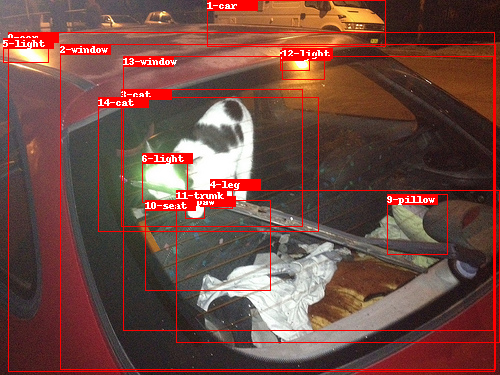

**************************************************
gt_boxes 0: 0-car
gt_boxes 1: 1-car
gt_boxes 2: 2-window
gt_boxes 3: 3-cat
gt_boxes 4: 4-leg
gt_boxes 5: 5-light
gt_boxes 6: 6-light
gt_boxes 7: 7-light
gt_boxes 8: 8-paw
gt_boxes 9: 9-pillow
gt_boxes 10: 10-seat
gt_boxes 11: 11-trunk
gt_boxes 12: 12-light
gt_boxes 13: 13-window
gt_boxes 14: 14-cat
**************************************************
gt_rels 0: ('3-cat', 'in', '0-car')
gt_rels 1: ('9-pillow', 'in', '11-trunk')
gt_rels 2: ('7-light', 'on', '0-car')
gt_rels 3: ('5-light', 'on', '0-car')
gt_rels 4: ('3-cat', 'in', '0-car')
gt_rels 5: ('2-window', 'on', '0-car')
gt_rels 6: ('3-cat', 'in', '0-car')
gt_rels 7: ('8-paw', 'of', '3-cat')
gt_rels 8: ('3-cat', 'on', '10-seat')
**************************************************
pred_rels 0: ('8-paw', 'of', '3-cat')
pred_rels 1: ('8-paw', 'of', '14-cat')
pred_rels 2: ('14-cat', 'on', '0-car')
pred_rels 3: ('3-cat', 'on', '0-car')
pred_rels 4: ('4-leg', 'of', '3-cat')
pred_rels 5: ('4

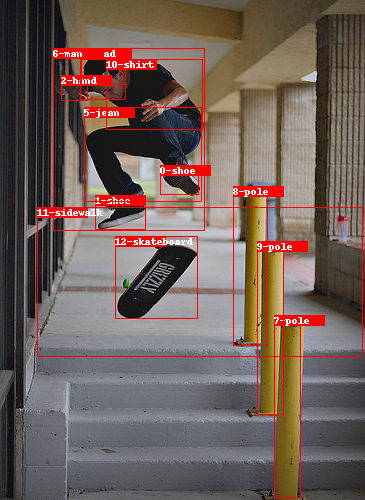

**************************************************
gt_boxes 0: 0-shoe
gt_boxes 1: 1-shoe
gt_boxes 2: 2-hand
gt_boxes 3: 3-hat
gt_boxes 4: 4-head
gt_boxes 5: 5-jean
gt_boxes 6: 6-man
gt_boxes 7: 7-pole
gt_boxes 8: 8-pole
gt_boxes 9: 9-pole
gt_boxes 10: 10-shirt
gt_boxes 11: 11-sidewalk
gt_boxes 12: 12-skateboard
**************************************************
gt_rels 0: ('6-man', 'wearing', '5-jean')
gt_rels 1: ('6-man', 'has', '1-shoe')
gt_rels 2: ('6-man', 'has', '2-hand')
gt_rels 3: ('6-man', 'has', '4-head')
gt_rels 4: ('4-head', 'has', '3-hat')
gt_rels 5: ('6-man', 'wearing', '0-shoe')
gt_rels 6: ('4-head', 'wearing', '3-hat')
gt_rels 7: ('6-man', 'has', '4-head')
gt_rels 8: ('6-man', 'wearing', '10-shirt')
gt_rels 9: ('6-man', 'wearing', '3-hat')
**************************************************
pred_rels 0: ('6-man', 'wearing', '3-hat')
pred_rels 1: ('3-hat', 'on', '4-head')
pred_rels 2: ('6-man', 'wearing', '5-jean')
pred_rels 3: ('6-man', 'wearing', '10-shirt')
pred_rels 4:

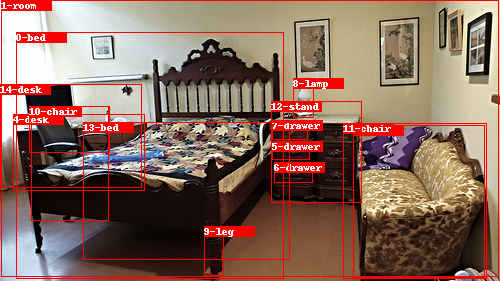

**************************************************
gt_boxes 0: 0-bed
gt_boxes 1: 1-room
gt_boxes 2: 2-bench
gt_boxes 3: 3-chair
gt_boxes 4: 4-desk
gt_boxes 5: 5-drawer
gt_boxes 6: 6-drawer
gt_boxes 7: 7-drawer
gt_boxes 8: 8-lamp
gt_boxes 9: 9-leg
gt_boxes 10: 10-chair
gt_boxes 11: 11-chair
gt_boxes 12: 12-stand
gt_boxes 13: 13-bed
gt_boxes 14: 14-desk
**************************************************
gt_rels 0: ('0-bed', 'in', '1-room')
gt_rels 1: ('11-chair', 'near', '0-bed')
gt_rels 2: ('2-bench', 'in', '1-room')
gt_rels 3: ('9-leg', 'of', '0-bed')
**************************************************
pred_rels 0: ('8-lamp', 'on', '12-stand')
pred_rels 1: ('0-bed', 'in', '1-room')
pred_rels 2: ('6-drawer', 'on', '12-stand')
pred_rels 3: ('5-drawer', 'on', '12-stand')
pred_rels 4: ('7-drawer', 'on', '12-stand')
pred_rels 5: ('11-chair', 'in', '1-room')
pred_rels 6: ('2-bench', 'in', '1-room')
pred_rels 7: ('13-bed', 'in', '1-room')
pred_rels 8: ('10-chair', 'in', '1-room')
pred_rels 9: 

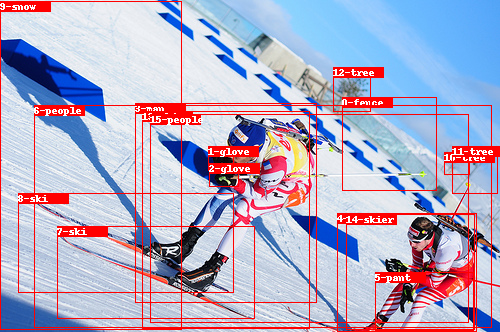

**************************************************
gt_boxes 0: 0-fence
gt_boxes 1: 1-glove
gt_boxes 2: 2-glove
gt_boxes 3: 3-man
gt_boxes 4: 4-men
gt_boxes 5: 5-pant
gt_boxes 6: 6-people
gt_boxes 7: 7-ski
gt_boxes 8: 8-ski
gt_boxes 9: 9-snow
gt_boxes 10: 10-tree
gt_boxes 11: 11-tree
gt_boxes 12: 12-tree
gt_boxes 13: 13-skier
gt_boxes 14: 14-skier
gt_boxes 15: 15-people
**************************************************
gt_rels 0: ('6-people', 'with', '8-ski')
gt_rels 1: ('3-man', 'on', '7-ski')
gt_rels 2: ('3-man', 'wearing', '1-glove')
gt_rels 3: ('3-man', 'wearing', '2-glove')
gt_rels 4: ('3-man', 'wearing', '2-glove')
gt_rels 5: ('3-man', 'wearing', '1-glove')
**************************************************
pred_rels 0: ('3-man', 'on', '7-ski')
pred_rels 1: ('3-man', 'on', '8-ski')
pred_rels 2: ('14-skier', 'wearing', '5-pant')
pred_rels 3: ('3-man', 'wearing', '1-glove')
pred_rels 4: ('3-man', 'wearing', '2-glove')
pred_rels 5: ('5-pant', 'on', '14-skier')
pred_rels 6: ('13-skie

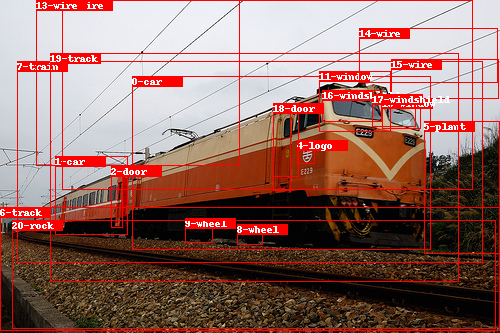

**************************************************
gt_boxes 0: 0-car
gt_boxes 1: 1-car
gt_boxes 2: 2-door
gt_boxes 3: 3-door
gt_boxes 4: 4-logo
gt_boxes 5: 5-plant
gt_boxes 6: 6-track
gt_boxes 7: 7-train
gt_boxes 8: 8-wheel
gt_boxes 9: 9-wheel
gt_boxes 10: 10-window
gt_boxes 11: 11-window
gt_boxes 12: 12-wire
gt_boxes 13: 13-wire
gt_boxes 14: 14-wire
gt_boxes 15: 15-wire
gt_boxes 16: 16-windshield
gt_boxes 17: 17-windshield
gt_boxes 18: 18-door
gt_boxes 19: 19-track
gt_boxes 20: 20-rock
**************************************************
gt_rels 0: ('7-train', 'on', '6-track')
gt_rels 1: ('16-windshield', 'on', '7-train')
gt_rels 2: ('17-windshield', 'of', '7-train')
gt_rels 3: ('3-door', 'of', '7-train')
gt_rels 4: ('5-plant', 'near', '7-train')
gt_rels 5: ('15-wire', 'above', '7-train')
gt_rels 6: ('14-wire', 'above', '7-train')
gt_rels 7: ('12-wire', 'above', '7-train')
gt_rels 8: ('13-wire', 'above', '7-train')
gt_rels 9: ('13-wire', 'above', '7-train')
gt_rels 10: ('10-window', 'on

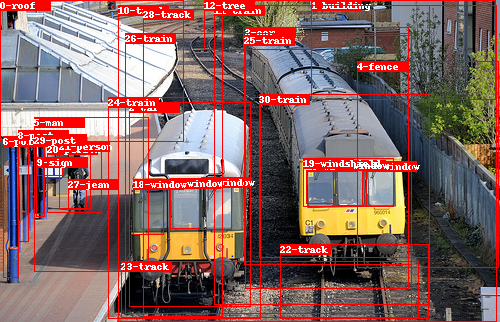

**************************************************
gt_boxes 0: 0-roof
gt_boxes 1: 1-building
gt_boxes 2: 2-car
gt_boxes 3: 3-car
gt_boxes 4: 4-fence
gt_boxes 5: 5-man
gt_boxes 6: 6-pole
gt_boxes 7: 7-pole
gt_boxes 8: 8-post
gt_boxes 9: 9-sign
gt_boxes 10: 10-track
gt_boxes 11: 11-train
gt_boxes 12: 12-tree
gt_boxes 13: 13-window
gt_boxes 14: 14-window
gt_boxes 15: 15-window
gt_boxes 16: 16-window
gt_boxes 17: 17-window
gt_boxes 18: 18-window
gt_boxes 19: 19-windshield
gt_boxes 20: 20-person
gt_boxes 21: 21-person
gt_boxes 22: 22-track
gt_boxes 23: 23-track
gt_boxes 24: 24-train
gt_boxes 25: 25-train
gt_boxes 26: 26-train
gt_boxes 27: 27-jean
gt_boxes 28: 28-track
gt_boxes 29: 29-post
gt_boxes 30: 30-train
**************************************************
gt_rels 0: ('15-window', 'on', '2-car')
gt_rels 1: ('17-window', 'of', '3-car')
gt_rels 2: ('18-window', 'of', '2-car')
gt_rels 3: ('16-window', 'of', '3-car')
gt_rels 4: ('14-window', 'of', '2-car')
gt_rels 5: ('2-car', 'on', '22-tra

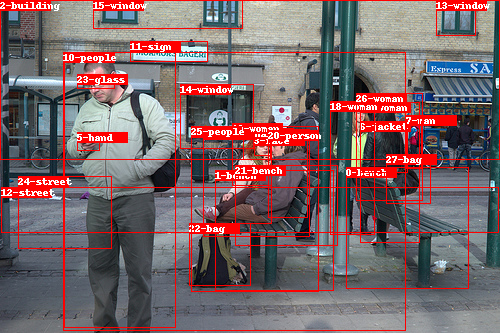

**************************************************
gt_boxes 0: 0-bench
gt_boxes 1: 1-bench
gt_boxes 2: 2-building
gt_boxes 3: 3-face
gt_boxes 4: 4-hair
gt_boxes 5: 5-hand
gt_boxes 6: 6-jacket
gt_boxes 7: 7-man
gt_boxes 8: 8-man
gt_boxes 9: 9-man
gt_boxes 10: 10-people
gt_boxes 11: 11-sign
gt_boxes 12: 12-street
gt_boxes 13: 13-window
gt_boxes 14: 14-window
gt_boxes 15: 15-window
gt_boxes 16: 16-woman
gt_boxes 17: 17-woman
gt_boxes 18: 18-woman
gt_boxes 19: 19-woman
gt_boxes 20: 20-person
gt_boxes 21: 21-bench
gt_boxes 22: 22-bag
gt_boxes 23: 23-glass
gt_boxes 24: 24-street
gt_boxes 25: 25-people
gt_boxes 26: 26-woman
gt_boxes 27: 27-bag
**************************************************
gt_rels 0: ('11-sign', 'on', '2-building')
gt_rels 1: ('10-people', 'on', '1-bench')
gt_rels 2: ('14-window', 'on', '2-building')
gt_rels 3: ('8-man', 'on', '12-street')
gt_rels 4: ('4-hair', 'of', '16-woman')
gt_rels 5: ('5-hand', 'of', '8-man')
gt_rels 6: ('10-people', 'sitting on', '1-bench')
gt_rels

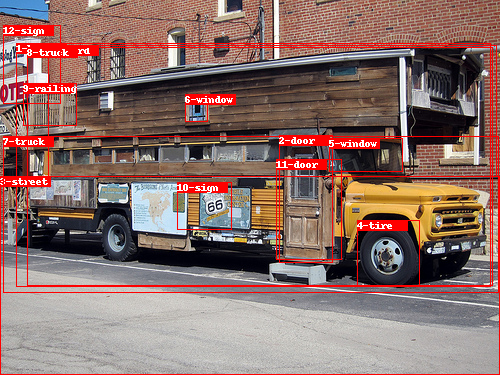

**************************************************
gt_boxes 0: 0-board
gt_boxes 1: 1-bus
gt_boxes 2: 2-door
gt_boxes 3: 3-street
gt_boxes 4: 4-tire
gt_boxes 5: 5-window
gt_boxes 6: 6-window
gt_boxes 7: 7-truck
gt_boxes 8: 8-truck
gt_boxes 9: 9-railing
gt_boxes 10: 10-sign
gt_boxes 11: 11-door
gt_boxes 12: 12-sign
**************************************************
gt_rels 0: ('0-board', 'above', '7-truck')
gt_rels 1: ('11-door', 'on', '1-bus')
gt_rels 2: ('4-tire', 'on', '1-bus')
gt_rels 3: ('2-door', 'on', '1-bus')
gt_rels 4: ('5-window', 'on', '1-bus')
**************************************************
pred_rels 0: ('6-window', 'on', '1-bus')
pred_rels 1: ('10-sign', 'on', '1-bus')
pred_rels 2: ('1-bus', 'on', '3-street')
pred_rels 3: ('0-board', 'on', '1-bus')
pred_rels 4: ('2-door', 'on', '1-bus')
pred_rels 5: ('11-door', 'on', '1-bus')
pred_rels 6: ('4-tire', 'on', '1-bus')
pred_rels 7: ('8-truck', 'on', '3-street')
pred_rels 8: ('5-window', 'on', '1-bus')
pred_rels 9: ('7-truck', 

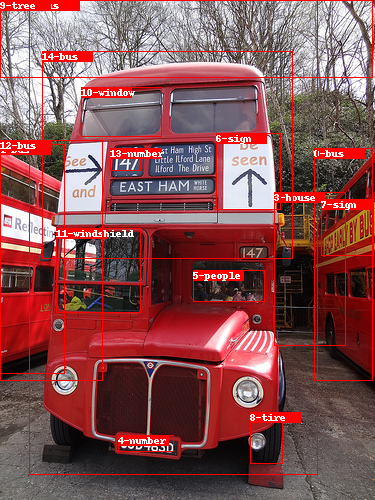

**************************************************
gt_boxes 0: 0-bus
gt_boxes 1: 1-bus
gt_boxes 2: 2-bus
gt_boxes 3: 3-house
gt_boxes 4: 4-number
gt_boxes 5: 5-people
gt_boxes 6: 6-sign
gt_boxes 7: 7-sign
gt_boxes 8: 8-tire
gt_boxes 9: 9-tree
gt_boxes 10: 10-window
gt_boxes 11: 11-windshield
gt_boxes 12: 12-bus
gt_boxes 13: 13-number
gt_boxes 14: 14-bus
**************************************************
gt_rels 0: ('6-sign', 'on', '2-bus')
gt_rels 1: ('7-sign', 'on', '0-bus')
gt_rels 2: ('5-people', 'in', '2-bus')
gt_rels 3: ('2-bus', 'has', '4-number')
gt_rels 4: ('6-sign', 'with', '13-number')
gt_rels 5: ('11-windshield', 'on', '2-bus')
**************************************************
pred_rels 0: ('4-number', 'on', '2-bus')
pred_rels 1: ('13-number', 'on', '2-bus')
pred_rels 2: ('10-window', 'on', '2-bus')
pred_rels 3: ('6-sign', 'on', '2-bus')
pred_rels 4: ('7-sign', 'on', '0-bus')
pred_rels 5: ('11-windshield', 'on', '2-bus')
pred_rels 6: ('8-tire', 'on', '2-bus')
pred_rels 7: (

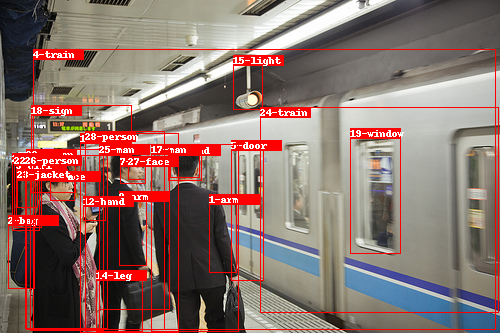

**************************************************
gt_boxes 0: 0-arm
gt_boxes 1: 1-arm
gt_boxes 2: 2-bag
gt_boxes 3: 3-coat
gt_boxes 4: 4-train
gt_boxes 5: 5-door
gt_boxes 6: 6-face
gt_boxes 7: 7-face
gt_boxes 8: 8-woman
gt_boxes 9: 9-girl
gt_boxes 10: 10-hair
gt_boxes 11: 11-hair
gt_boxes 12: 12-hand
gt_boxes 13: 13-head
gt_boxes 14: 14-leg
gt_boxes 15: 15-light
gt_boxes 16: 16-man
gt_boxes 17: 17-man
gt_boxes 18: 18-sign
gt_boxes 19: 19-window
gt_boxes 20: 20-woman
gt_boxes 21: 21-person
gt_boxes 22: 22-woman
gt_boxes 23: 23-jacket
gt_boxes 24: 24-train
gt_boxes 25: 25-man
gt_boxes 26: 26-person
gt_boxes 27: 27-face
gt_boxes 28: 28-person
**************************************************
gt_rels 0: ('20-woman', 'carrying', '2-bag')
gt_rels 1: ('8-woman', 'has', '10-hair')
gt_rels 2: ('21-person', 'wearing', '3-coat')
gt_rels 3: ('22-woman', 'wearing', '23-jacket')
gt_rels 4: ('19-window', 'on', '4-train')
gt_rels 5: ('4-train', 'has', '5-door')
gt_rels 6: ('4-train', 'has', '5-door'

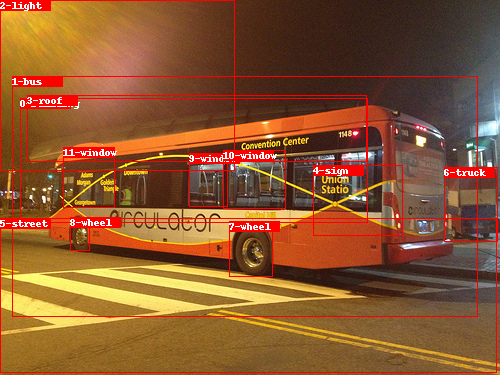

**************************************************
gt_boxes 0: 0-building
gt_boxes 1: 1-bus
gt_boxes 2: 2-light
gt_boxes 3: 3-roof
gt_boxes 4: 4-sign
gt_boxes 5: 5-street
gt_boxes 6: 6-truck
gt_boxes 7: 7-wheel
gt_boxes 8: 8-wheel
gt_boxes 9: 9-window
gt_boxes 10: 10-window
gt_boxes 11: 11-window
**************************************************
gt_rels 0: ('8-wheel', 'of', '1-bus')
gt_rels 1: ('7-wheel', 'of', '1-bus')
gt_rels 2: ('7-wheel', 'of', '1-bus')
gt_rels 3: ('10-window', 'of', '1-bus')
gt_rels 4: ('7-wheel', 'of', '1-bus')
gt_rels 5: ('3-roof', 'of', '0-building')
gt_rels 6: ('0-building', 'behind', '1-bus')
gt_rels 7: ('9-window', 'near', '1-bus')
**************************************************
pred_rels 0: ('1-bus', 'on', '5-street')
pred_rels 1: ('10-window', 'on', '1-bus')
pred_rels 2: ('9-window', 'on', '1-bus')
pred_rels 3: ('11-window', 'on', '1-bus')
pred_rels 4: ('4-sign', 'on', '1-bus')
pred_rels 5: ('7-wheel', 'on', '1-bus')
pred_rels 6: ('8-wheel', 'on', '1-b

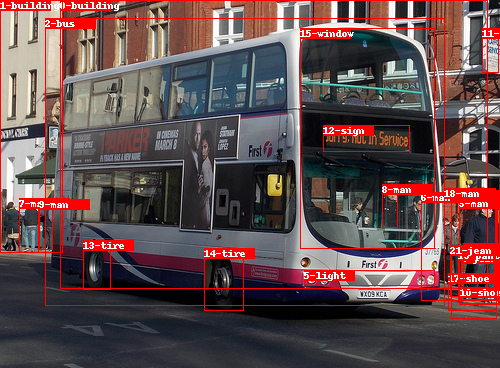

**************************************************
gt_boxes 0: 0-building
gt_boxes 1: 1-building
gt_boxes 2: 2-bus
gt_boxes 3: 3-man
gt_boxes 4: 4-jean
gt_boxes 5: 5-light
gt_boxes 6: 6-man
gt_boxes 7: 7-man
gt_boxes 8: 8-man
gt_boxes 9: 9-man
gt_boxes 10: 10-shoe
gt_boxes 11: 11-sign
gt_boxes 12: 12-sign
gt_boxes 13: 13-tire
gt_boxes 14: 14-tire
gt_boxes 15: 15-window
gt_boxes 16: 16-man
gt_boxes 17: 17-shoe
gt_boxes 18: 18-man
gt_boxes 19: 19-pant
gt_boxes 20: 20-pant
gt_boxes 21: 21-jean
**************************************************
gt_rels 0: ('12-sign', 'on', '2-bus')
gt_rels 1: ('3-man', 'wearing', '10-shoe')
gt_rels 2: ('16-man', 'wearing', '17-shoe')
gt_rels 3: ('16-man', 'wearing', '19-pant')
gt_rels 4: ('6-man', 'wearing', '19-pant')
gt_rels 5: ('16-man', 'wearing', '20-pant')
gt_rels 6: ('16-man', 'wearing', '19-pant')
gt_rels 7: ('16-man', 'wearing', '21-jean')
gt_rels 8: ('6-man', 'wearing', '4-jean')
**************************************************
pred_rels 0: ('3

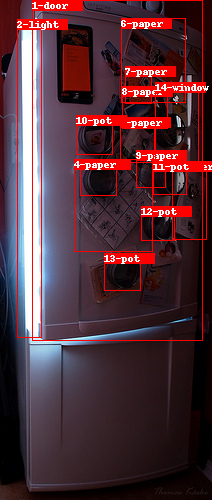

**************************************************
gt_boxes 0: 0-pot
gt_boxes 1: 1-door
gt_boxes 2: 2-light
gt_boxes 3: 3-paper
gt_boxes 4: 4-paper
gt_boxes 5: 5-paper
gt_boxes 6: 6-paper
gt_boxes 7: 7-paper
gt_boxes 8: 8-paper
gt_boxes 9: 9-paper
gt_boxes 10: 10-pot
gt_boxes 11: 11-pot
gt_boxes 12: 12-pot
gt_boxes 13: 13-pot
gt_boxes 14: 14-window
**************************************************
gt_rels 0: ('10-pot', 'hanging from', '1-door')
gt_rels 1: ('13-pot', 'hanging from', '1-door')
gt_rels 2: ('12-pot', 'hanging from', '1-door')
gt_rels 3: ('11-pot', 'hanging from', '1-door')
gt_rels 4: ('0-pot', 'hanging from', '1-door')
gt_rels 5: ('2-light', 'in', '1-door')
**************************************************
pred_rels 0: ('3-paper', 'on', '1-door')
pred_rels 1: ('6-paper', 'on', '1-door')
pred_rels 2: ('5-paper', 'on', '1-door')
pred_rels 3: ('7-paper', 'on', '1-door')
pred_rels 4: ('14-window', 'on', '1-door')
pred_rels 5: ('4-paper', 'on', '1-door')
pred_rels 6: ('9-pape

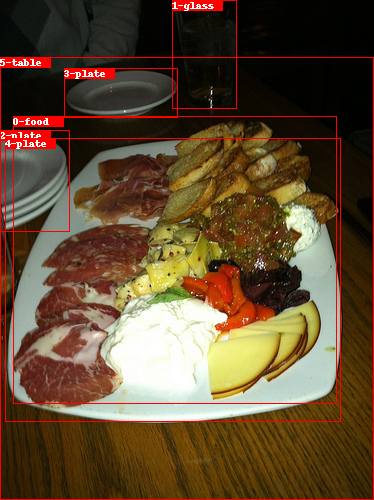

**************************************************
gt_boxes 0: 0-food
gt_boxes 1: 1-glass
gt_boxes 2: 2-plate
gt_boxes 3: 3-plate
gt_boxes 4: 4-plate
gt_boxes 5: 5-table
**************************************************
gt_rels 0: ('4-plate', 'on', '5-table')
gt_rels 1: ('4-plate', 'on', '5-table')
gt_rels 2: ('0-food', 'on', '4-plate')
gt_rels 3: ('4-plate', 'on', '5-table')
gt_rels 4: ('4-plate', 'on', '5-table')
gt_rels 5: ('4-plate', 'on', '5-table')
gt_rels 6: ('4-plate', 'on', '5-table')
gt_rels 7: ('0-food', 'on', '4-plate')
gt_rels 8: ('1-glass', 'on', '5-table')
**************************************************
pred_rels 0: ('0-food', 'on', '4-plate')
pred_rels 1: ('2-plate', 'on', '5-table')
pred_rels 2: ('4-plate', 'on', '5-table')
pred_rels 3: ('1-glass', 'on', '5-table')
pred_rels 4: ('3-plate', 'on', '5-table')
pred_rels 5: ('0-food', 'on', '5-table')
pred_rels 6: ('4-plate', 'of', '0-food')
pred_rels 7: ('5-table', 'under', '4-plate')
pred_rels 8: ('2-plate', 'of', '0-

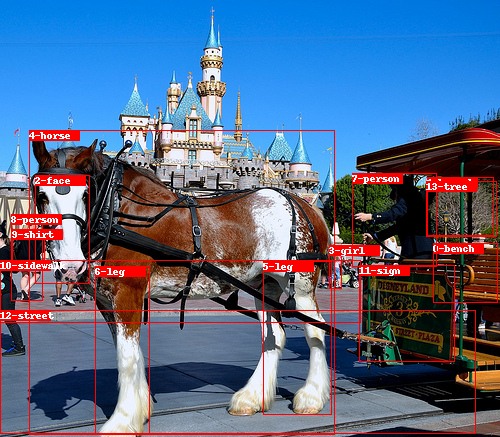

**************************************************
gt_boxes 0: 0-bench
gt_boxes 1: 1-branch
gt_boxes 2: 2-face
gt_boxes 3: 3-girl
gt_boxes 4: 4-horse
gt_boxes 5: 5-leg
gt_boxes 6: 6-leg
gt_boxes 7: 7-person
gt_boxes 8: 8-person
gt_boxes 9: 9-shirt
gt_boxes 10: 10-sidewalk
gt_boxes 11: 11-sign
gt_boxes 12: 12-street
gt_boxes 13: 13-tree
**************************************************
gt_rels 0: ('8-person', 'walking on', '10-sidewalk')
gt_rels 1: ('13-tree', 'with', '1-branch')
gt_rels 2: ('4-horse', 'has', '5-leg')
gt_rels 3: ('4-horse', 'has', '6-leg')
gt_rels 4: ('4-horse', 'has', '2-face')
gt_rels 5: ('8-person', 'wearing', '9-shirt')
**************************************************
pred_rels 0: ('4-horse', 'on', '12-street')
pred_rels 1: ('8-person', 'wearing', '9-shirt')
pred_rels 2: ('4-horse', 'has', '5-leg')
pred_rels 3: ('4-horse', 'has', '6-leg')
pred_rels 4: ('6-leg', 'of', '4-horse')
pred_rels 5: ('5-leg', 'of', '4-horse')
pred_rels 6: ('4-horse', 'has', '2-face')
pred

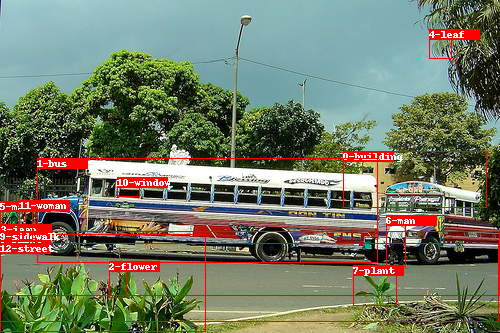

**************************************************
gt_boxes 0: 0-building
gt_boxes 1: 1-bus
gt_boxes 2: 2-flower
gt_boxes 3: 3-jean
gt_boxes 4: 4-leaf
gt_boxes 5: 5-man
gt_boxes 6: 6-man
gt_boxes 7: 7-plant
gt_boxes 8: 8-plant
gt_boxes 9: 9-sidewalk
gt_boxes 10: 10-window
gt_boxes 11: 11-woman
gt_boxes 12: 12-street
**************************************************
gt_rels 0: ('7-plant', 'near', '12-street')
gt_rels 1: ('5-man', 'has', '3-jean')
gt_rels 2: ('5-man', 'looking at', '1-bus')
gt_rels 3: ('1-bus', 'has', '10-window')
gt_rels 4: ('8-plant', 'has', '2-flower')
gt_rels 5: ('1-bus', 'on', '12-street')
gt_rels 6: ('11-woman', 'on', '9-sidewalk')
gt_rels 7: ('1-bus', 'parked on', '12-street')
gt_rels 8: ('1-bus', 'has', '10-window')
gt_rels 9: ('6-man', 'walking on', '12-street')
**************************************************
pred_rels 0: ('5-man', 'wearing', '3-jean')
pred_rels 1: ('10-window', 'on', '1-bus')
pred_rels 2: ('11-woman', 'wearing', '3-jean')
pred_rels 3: ('1-b

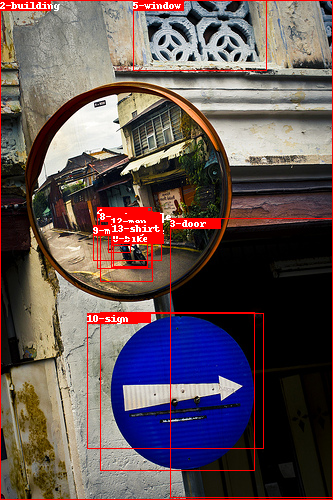

**************************************************
gt_boxes 0: 0-bike
gt_boxes 1: 1-sign
gt_boxes 2: 2-building
gt_boxes 3: 3-door
gt_boxes 4: 4-man
gt_boxes 5: 5-window
gt_boxes 6: 6-man
gt_boxes 7: 7-helmet
gt_boxes 8: 8-motorcycle
gt_boxes 9: 9-motorcycle
gt_boxes 10: 10-sign
gt_boxes 11: 11-person
gt_boxes 12: 12-man
gt_boxes 13: 13-shirt
**************************************************
gt_rels 0: ('1-sign', 'on', '3-door')
gt_rels 1: ('5-window', 'on', '2-building')
gt_rels 2: ('4-man', 'wearing', '7-helmet')
gt_rels 3: ('4-man', 'riding', '8-motorcycle')
gt_rels 4: ('11-person', 'in', '0-bike')
gt_rels 5: ('4-man', 'wears', '13-shirt')
**************************************************
pred_rels 0: ('5-window', 'on', '2-building')
pred_rels 1: ('4-man', 'wearing', '7-helmet')
pred_rels 2: ('6-man', 'wearing', '7-helmet')
pred_rels 3: ('11-person', 'wearing', '7-helmet')
pred_rels 4: ('12-man', 'wearing', '7-helmet')
pred_rels 5: ('3-door', 'on', '2-building')
pred_rels 6: ('4-m

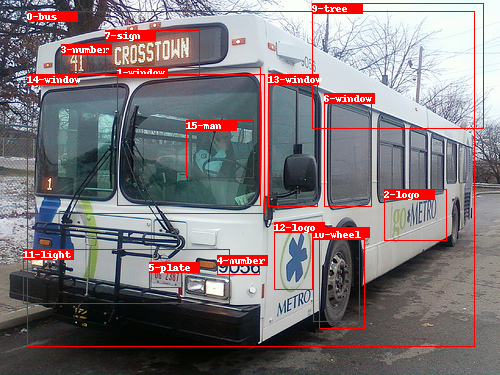

**************************************************
gt_boxes 0: 0-bus
gt_boxes 1: 1-window
gt_boxes 2: 2-logo
gt_boxes 3: 3-number
gt_boxes 4: 4-number
gt_boxes 5: 5-plate
gt_boxes 6: 6-window
gt_boxes 7: 7-sign
gt_boxes 8: 8-tire
gt_boxes 9: 9-tree
gt_boxes 10: 10-wheel
gt_boxes 11: 11-light
gt_boxes 12: 12-logo
gt_boxes 13: 13-window
gt_boxes 14: 14-window
gt_boxes 15: 15-man
**************************************************
gt_rels 0: ('5-plate', 'on', '0-bus')
gt_rels 1: ('9-tree', 'behind', '0-bus')
gt_rels 2: ('1-window', 'of', '0-bus')
gt_rels 3: ('10-wheel', 'of', '0-bus')
gt_rels 4: ('6-window', 'of', '0-bus')
gt_rels 5: ('10-wheel', 'of', '0-bus')
gt_rels 6: ('4-number', 'of', '0-bus')
gt_rels 7: ('11-light', 'of', '0-bus')
gt_rels 8: ('12-logo', 'on', '0-bus')
gt_rels 9: ('10-wheel', 'of', '0-bus')
gt_rels 10: ('1-window', 'of', '0-bus')
gt_rels 11: ('6-window', 'on', '0-bus')
gt_rels 12: ('13-window', 'on', '0-bus')
gt_rels 13: ('1-window', 'on', '0-bus')
gt_rels 14: ('0-bu

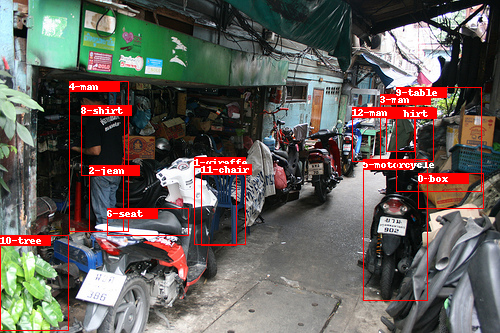

**************************************************
gt_boxes 0: 0-box
gt_boxes 1: 1-giraffe
gt_boxes 2: 2-jean
gt_boxes 3: 3-man
gt_boxes 4: 4-man
gt_boxes 5: 5-motorcycle
gt_boxes 6: 6-seat
gt_boxes 7: 7-shirt
gt_boxes 8: 8-shirt
gt_boxes 9: 9-table
gt_boxes 10: 10-tree
gt_boxes 11: 11-chair
gt_boxes 12: 12-man
**************************************************
gt_rels 0: ('4-man', 'wearing', '8-shirt')
**************************************************
pred_rels 0: ('4-man', 'wearing', '2-jean')
pred_rels 1: ('3-man', 'wearing', '7-shirt')
pred_rels 2: ('4-man', 'wearing', '8-shirt')
pred_rels 3: ('12-man', 'wearing', '7-shirt')
pred_rels 4: ('3-man', 'on', '5-motorcycle')
pred_rels 5: ('8-shirt', 'on', '4-man')
pred_rels 6: ('2-jean', 'on', '4-man')
pred_rels 7: ('12-man', 'on', '5-motorcycle')
pred_rels 8: ('7-shirt', 'on', '12-man')
pred_rels 9: ('7-shirt', 'on', '3-man')
pred_rels 10: ('0-box', 'on', '5-motorcycle')
pred_rels 11: ('0-box', 'on', '9-table')
pred_rels 12: ('4-man', 

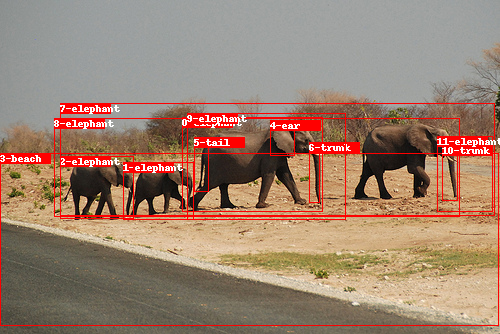

**************************************************
gt_boxes 0: 0-elephant
gt_boxes 1: 1-elephant
gt_boxes 2: 2-elephant
gt_boxes 3: 3-beach
gt_boxes 4: 4-ear
gt_boxes 5: 5-tail
gt_boxes 6: 6-trunk
gt_boxes 7: 7-elephant
gt_boxes 8: 8-elephant
gt_boxes 9: 9-elephant
gt_boxes 10: 10-trunk
gt_boxes 11: 11-elephant
**************************************************
gt_rels 0: ('0-elephant', 'walking on', '3-beach')
gt_rels 1: ('7-elephant', 'walking on', '3-beach')
gt_rels 2: ('4-ear', 'of', '0-elephant')
gt_rels 3: ('10-trunk', 'of', '11-elephant')
gt_rels 4: ('0-elephant', 'has', '5-tail')
**************************************************
pred_rels 0: ('5-tail', 'of', '9-elephant')
pred_rels 1: ('4-ear', 'of', '9-elephant')
pred_rels 2: ('6-trunk', 'of', '9-elephant')
pred_rels 3: ('5-tail', 'of', '0-elephant')
pred_rels 4: ('4-ear', 'of', '0-elephant')
pred_rels 5: ('10-trunk', 'of', '7-elephant')
pred_rels 6: ('6-trunk', 'of', '0-elephant')
pred_rels 7: ('10-trunk', 'of', '11-elephant

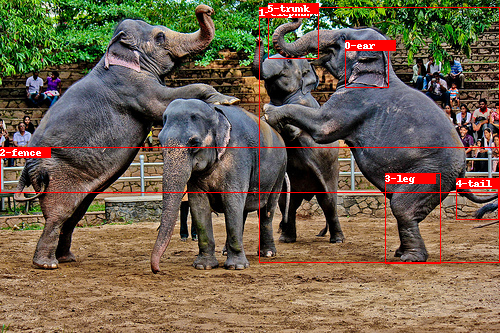

**************************************************
gt_boxes 0: 0-ear
gt_boxes 1: 1-elephant
gt_boxes 2: 2-fence
gt_boxes 3: 3-leg
gt_boxes 4: 4-tail
gt_boxes 5: 5-trunk
**************************************************
gt_rels 0: ('5-trunk', 'of', '1-elephant')
gt_rels 1: ('5-trunk', 'of', '1-elephant')
gt_rels 2: ('5-trunk', 'of', '1-elephant')
gt_rels 3: ('5-trunk', 'of', '1-elephant')
gt_rels 4: ('4-tail', 'of', '1-elephant')
gt_rels 5: ('5-trunk', 'of', '1-elephant')
gt_rels 6: ('3-leg', 'of', '1-elephant')
gt_rels 7: ('0-ear', 'of', '1-elephant')
gt_rels 8: ('4-tail', 'of', '1-elephant')
gt_rels 9: ('1-elephant', 'on', '3-leg')
gt_rels 10: ('3-leg', 'on', '1-elephant')
**************************************************
pred_rels 0: ('1-elephant', 'has', '5-trunk')
pred_rels 1: ('1-elephant', 'has', '0-ear')
pred_rels 2: ('1-elephant', 'has', '4-tail')
pred_rels 3: ('3-leg', 'of', '1-elephant')
pred_rels 4: ('1-elephant', 'has', '3-leg')
pred_rels 5: ('4-tail', 'of', '1-elephant')

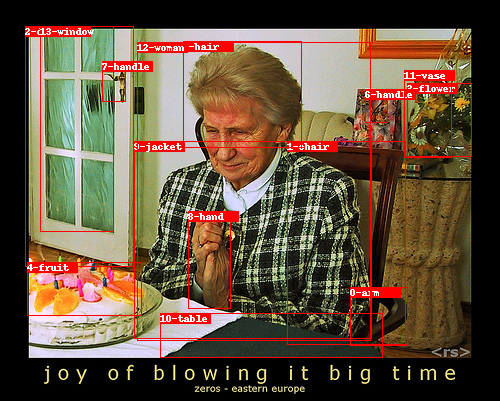

**************************************************
gt_boxes 0: 0-arm
gt_boxes 1: 1-chair
gt_boxes 2: 2-door
gt_boxes 3: 3-flower
gt_boxes 4: 4-fruit
gt_boxes 5: 5-hair
gt_boxes 6: 6-handle
gt_boxes 7: 7-handle
gt_boxes 8: 8-hand
gt_boxes 9: 9-jacket
gt_boxes 10: 10-table
gt_boxes 11: 11-vase
gt_boxes 12: 12-woman
gt_boxes 13: 13-window
**************************************************
gt_rels 0: ('1-chair', 'has', '0-arm')
gt_rels 1: ('12-woman', 'sitting on', '1-chair')
gt_rels 2: ('13-window', 'part of', '2-door')
gt_rels 3: ('13-window', 'in', '2-door')
gt_rels 4: ('7-handle', 'on back of', '2-door')
gt_rels 5: ('3-flower', 'near', '11-vase')
gt_rels 6: ('12-woman', 'wearing', '9-jacket')
**************************************************
pred_rels 0: ('7-handle', 'on', '2-door')
pred_rels 1: ('12-woman', 'wearing', '9-jacket')
pred_rels 2: ('3-flower', 'in', '11-vase')
pred_rels 3: ('12-woman', 'has', '5-hair')
pred_rels 4: ('13-window', 'on', '2-door')
pred_rels 5: ('2-door', 'ha

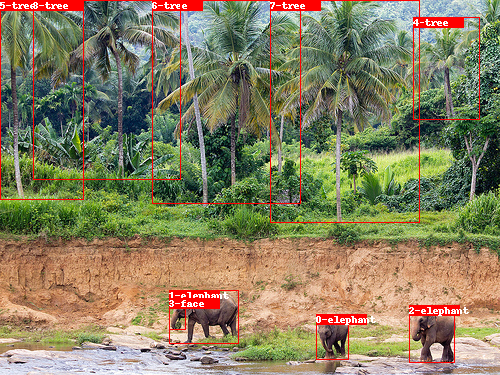

**************************************************
gt_boxes 0: 0-elephant
gt_boxes 1: 1-elephant
gt_boxes 2: 2-elephant
gt_boxes 3: 3-face
gt_boxes 4: 4-tree
gt_boxes 5: 5-tree
gt_boxes 6: 6-tree
gt_boxes 7: 7-tree
gt_boxes 8: 8-tree
**************************************************
gt_rels 0: ('1-elephant', 'has', '3-face')
gt_rels 1: ('1-elephant', 'near', '0-elephant')
gt_rels 2: ('5-tree', 'near', '8-tree')
gt_rels 3: ('6-tree', 'near', '7-tree')
gt_rels 4: ('1-elephant', 'near', '0-elephant')
**************************************************
pred_rels 0: ('1-elephant', 'has', '3-face')
pred_rels 1: ('3-face', 'of', '1-elephant')
pred_rels 2: ('0-elephant', 'near', '1-elephant')
pred_rels 3: ('6-tree', 'behind', '1-elephant')
pred_rels 4: ('1-elephant', 'near', '0-elephant')
pred_rels 5: ('4-tree', 'behind', '1-elephant')
pred_rels 6: ('1-elephant', 'near', '8-tree')
pred_rels 7: ('7-tree', 'behind', '1-elephant')
pred_rels 8: ('1-elephant', 'under', '6-tree')
pred_rels 9: ('1-el

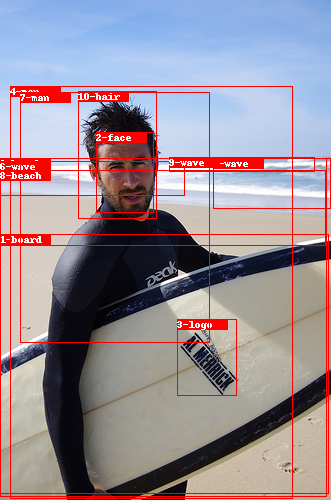

**************************************************
gt_boxes 0: 0-beach
gt_boxes 1: 1-board
gt_boxes 2: 2-face
gt_boxes 3: 3-logo
gt_boxes 4: 4-man
gt_boxes 5: 5-wave
gt_boxes 6: 6-wave
gt_boxes 7: 7-man
gt_boxes 8: 8-beach
gt_boxes 9: 9-wave
gt_boxes 10: 10-hair
**************************************************
gt_rels 0: ('3-logo', 'on', '1-board')
gt_rels 1: ('4-man', 'has', '2-face')
gt_rels 2: ('4-man', 'on', '8-beach')
gt_rels 3: ('3-logo', 'on', '1-board')
gt_rels 4: ('4-man', 'with', '1-board')
gt_rels 5: ('7-man', 'with', '10-hair')
**************************************************
pred_rels 0: ('3-logo', 'on', '1-board')
pred_rels 1: ('4-man', 'on', '0-beach')
pred_rels 2: ('4-man', 'on', '1-board')
pred_rels 3: ('4-man', 'has', '10-hair')
pred_rels 4: ('1-board', 'on', '0-beach')
pred_rels 5: ('7-man', 'on', '0-beach')
pred_rels 6: ('2-face', 'of', '4-man')
pred_rels 7: ('9-wave', 'on', '0-beach')
pred_rels 8: ('6-wave', 'on', '0-beach')
pred_rels 9: ('5-wave', 'on', '0-bea

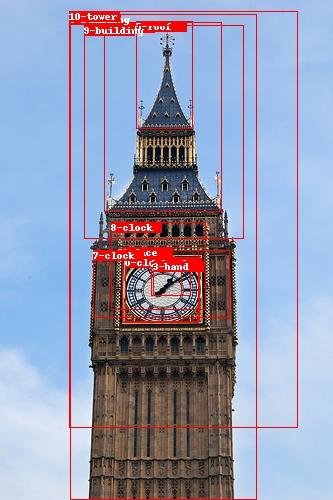

**************************************************
gt_boxes 0: 0-clock
gt_boxes 1: 1-face
gt_boxes 2: 2-hand
gt_boxes 3: 3-hand
gt_boxes 4: 4-roof
gt_boxes 5: 5-roof
gt_boxes 6: 6-building
gt_boxes 7: 7-clock
gt_boxes 8: 8-clock
gt_boxes 9: 9-building
gt_boxes 10: 10-tower
**************************************************
gt_rels 0: ('2-hand', 'of', '7-clock')
gt_rels 1: ('3-hand', 'of', '1-face')
gt_rels 2: ('2-hand', 'of', '8-clock')
gt_rels 3: ('5-roof', 'of', '9-building')
**************************************************
pred_rels 0: ('7-clock', 'on', '6-building')
pred_rels 1: ('8-clock', 'on', '6-building')
pred_rels 2: ('7-clock', 'on', '10-tower')
pred_rels 3: ('0-clock', 'on', '6-building')
pred_rels 4: ('2-hand', 'on', '0-clock')
pred_rels 5: ('3-hand', 'on', '0-clock')
pred_rels 6: ('3-hand', 'on', '7-clock')
pred_rels 7: ('2-hand', 'on', '7-clock')
pred_rels 8: ('8-clock', 'on', '10-tower')
pred_rels 9: ('1-face', 'on', '10-tower')
pred_rels 10: ('0-clock', 'on', '10-tow

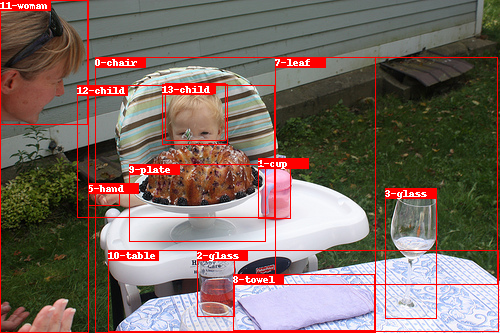

**************************************************
gt_boxes 0: 0-chair
gt_boxes 1: 1-cup
gt_boxes 2: 2-glass
gt_boxes 3: 3-glass
gt_boxes 4: 4-hair
gt_boxes 5: 5-hand
gt_boxes 6: 6-head
gt_boxes 7: 7-leaf
gt_boxes 8: 8-towel
gt_boxes 9: 9-plate
gt_boxes 10: 10-table
gt_boxes 11: 11-woman
gt_boxes 12: 12-child
gt_boxes 13: 13-child
**************************************************
gt_rels 0: ('12-child', 'sitting on', '0-chair')
gt_rels 1: ('13-child', 'with', '4-hair')
gt_rels 2: ('12-child', 'in', '0-chair')
gt_rels 3: ('9-plate', 'on', '0-chair')
gt_rels 4: ('0-chair', 'has', '9-plate')
gt_rels 5: ('8-towel', 'on', '10-table')
gt_rels 6: ('10-table', 'has', '8-towel')
gt_rels 7: ('2-glass', 'on', '10-table')
**************************************************
pred_rels 0: ('3-glass', 'on', '10-table')
pred_rels 1: ('8-towel', 'on', '10-table')
pred_rels 2: ('8-towel', 'on', '0-chair')
pred_rels 3: ('0-chair', 'at', '10-table')
pred_rels 4: ('11-woman', 'has', '6-head')
pred_rels 5: (

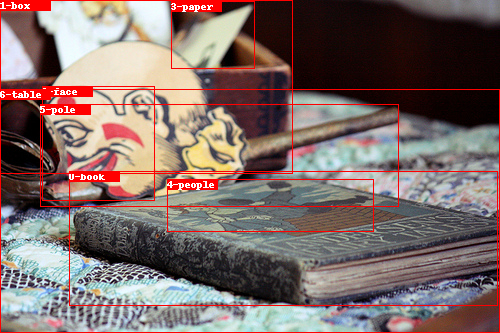

**************************************************
gt_boxes 0: 0-book
gt_boxes 1: 1-box
gt_boxes 2: 2-face
gt_boxes 3: 3-paper
gt_boxes 4: 4-people
gt_boxes 5: 5-pole
gt_boxes 6: 6-table
**************************************************
gt_rels 0: ('0-book', 'on', '6-table')
gt_rels 1: ('0-book', 'has', '4-people')
gt_rels 2: ('3-paper', 'in', '1-box')
gt_rels 3: ('0-book', 'on', '6-table')
gt_rels 4: ('2-face', 'near', '0-book')
gt_rels 5: ('2-face', 'in front of', '1-box')
**************************************************
pred_rels 0: ('0-book', 'on', '6-table')
pred_rels 1: ('4-people', 'on', '0-book')
pred_rels 2: ('5-pole', 'on', '6-table')
pred_rels 3: ('1-box', 'on', '6-table')
pred_rels 4: ('1-box', 'on', '5-pole')
pred_rels 5: ('3-paper', 'in', '1-box')
pred_rels 6: ('6-table', 'has', '5-pole')
pred_rels 7: ('4-people', 'near', '6-table')
pred_rels 8: ('3-paper', 'on', '6-table')
pred_rels 9: ('0-book', 'in', '1-box')
pred_rels 10: ('2-face', 'on', '6-table')
pred_rels 11: (

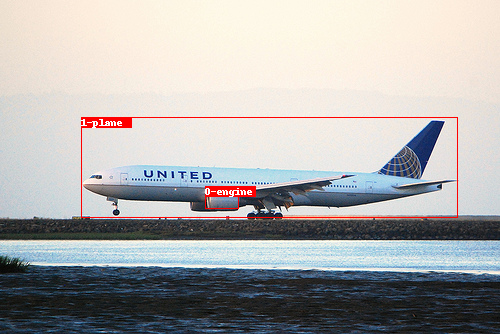

**************************************************
gt_boxes 0: 0-engine
gt_boxes 1: 1-plane
**************************************************
gt_rels 0: ('1-plane', 'has', '0-engine')
**************************************************
pred_rels 0: ('1-plane', 'has', '0-engine')
pred_rels 1: ('0-engine', 'on', '1-plane')
**************************************************
34


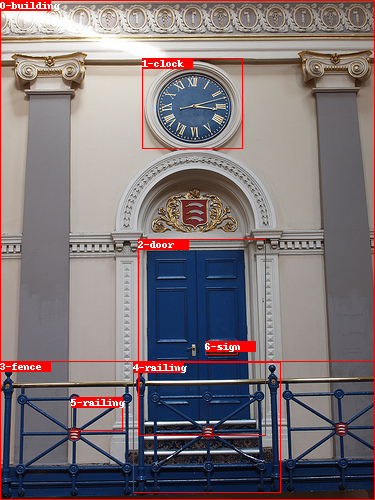

**************************************************
gt_boxes 0: 0-building
gt_boxes 1: 1-clock
gt_boxes 2: 2-door
gt_boxes 3: 3-fence
gt_boxes 4: 4-railing
gt_boxes 5: 5-railing
gt_boxes 6: 6-sign
**************************************************
gt_rels 0: ('3-fence', 'in front of', '2-door')
gt_rels 1: ('1-clock', 'above', '2-door')
gt_rels 2: ('6-sign', 'on', '2-door')
gt_rels 3: ('1-clock', 'above', '2-door')
gt_rels 4: ('2-door', 'on', '0-building')
gt_rels 5: ('3-fence', 'in front of', '2-door')
gt_rels 6: ('2-door', 'on', '0-building')
gt_rels 7: ('3-fence', 'in front of', '2-door')
**************************************************
pred_rels 0: ('6-sign', 'on', '2-door')
pred_rels 1: ('1-clock', 'on', '0-building')
pred_rels 2: ('5-railing', 'on', '3-fence')
pred_rels 3: ('4-railing', 'on', '3-fence')
pred_rels 4: ('6-sign', 'on', '3-fence')
pred_rels 5: ('0-building', 'behind', '3-fence')
pred_rels 6: ('2-door', 'on', '0-building')
pred_rels 7: ('5-railing', 'on', '0-building'

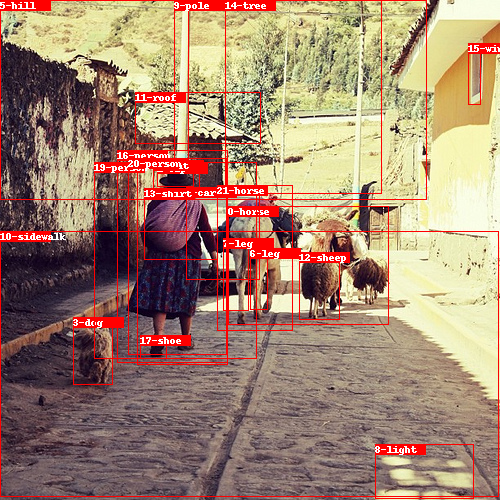

**************************************************
gt_boxes 0: 0-horse
gt_boxes 1: 1-cap
gt_boxes 2: 2-car
gt_boxes 3: 3-dog
gt_boxes 4: 4-girl
gt_boxes 5: 5-hill
gt_boxes 6: 6-leg
gt_boxes 7: 7-leg
gt_boxes 8: 8-light
gt_boxes 9: 9-pole
gt_boxes 10: 10-sidewalk
gt_boxes 11: 11-roof
gt_boxes 12: 12-sheep
gt_boxes 13: 13-shirt
gt_boxes 14: 14-tree
gt_boxes 15: 15-window
gt_boxes 16: 16-person
gt_boxes 17: 17-shoe
gt_boxes 18: 18-hat
gt_boxes 19: 19-person
gt_boxes 20: 20-person
gt_boxes 21: 21-horse
**************************************************
gt_rels 0: ('14-tree', 'on', '5-hill')
gt_rels 1: ('16-person', 'wears', '17-shoe')
gt_rels 2: ('16-person', 'wears', '18-hat')
gt_rels 3: ('2-car', 'in front of', '0-horse')
gt_rels 4: ('1-cap', 'of', '4-girl')
gt_rels 5: ('6-leg', 'of', '21-horse')
gt_rels 6: ('7-leg', 'of', '21-horse')
**************************************************
pred_rels 0: ('16-person', 'wearing', '13-shirt')
pred_rels 1: ('7-leg', 'of', '21-horse')
pred_rels 2: 

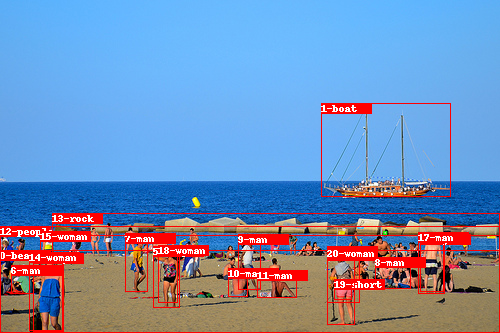

**************************************************
gt_boxes 0: 0-beach
gt_boxes 1: 1-boat
gt_boxes 2: 2-boy
gt_boxes 3: 3-woman
gt_boxes 4: 4-lady
gt_boxes 5: 5-lady
gt_boxes 6: 6-man
gt_boxes 7: 7-man
gt_boxes 8: 8-man
gt_boxes 9: 9-man
gt_boxes 10: 10-man
gt_boxes 11: 11-man
gt_boxes 12: 12-people
gt_boxes 13: 13-rock
gt_boxes 14: 14-woman
gt_boxes 15: 15-woman
gt_boxes 16: 16-woman
gt_boxes 17: 17-man
gt_boxes 18: 18-woman
gt_boxes 19: 19-short
gt_boxes 20: 20-woman
**************************************************
gt_rels 0: ('11-man', 'sitting on', '0-beach')
gt_rels 1: ('10-man', 'on', '0-beach')
gt_rels 2: ('3-woman', 'wearing', '19-short')
gt_rels 3: ('20-woman', 'at', '0-beach')
**************************************************
pred_rels 0: ('12-people', 'on', '0-beach')
pred_rels 1: ('3-woman', 'wearing', '19-short')
pred_rels 2: ('20-woman', 'wearing', '19-short')
pred_rels 3: ('6-man', 'on', '0-beach')
pred_rels 4: ('3-woman', 'on', '0-beach')
pred_rels 5: ('20-woman', 'o

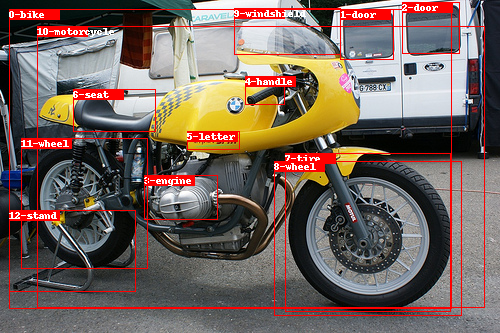

**************************************************
gt_boxes 0: 0-bike
gt_boxes 1: 1-door
gt_boxes 2: 2-door
gt_boxes 3: 3-engine
gt_boxes 4: 4-handle
gt_boxes 5: 5-letter
gt_boxes 6: 6-seat
gt_boxes 7: 7-tire
gt_boxes 8: 8-wheel
gt_boxes 9: 9-windshield
gt_boxes 10: 10-motorcycle
gt_boxes 11: 11-wheel
gt_boxes 12: 12-stand
**************************************************
gt_rels 0: ('8-wheel', 'on', '0-bike')
gt_rels 1: ('7-tire', 'on', '0-bike')
gt_rels 2: ('3-engine', 'on', '0-bike')
gt_rels 3: ('11-wheel', 'on', '0-bike')
gt_rels 4: ('4-handle', 'on', '0-bike')
**************************************************
pred_rels 0: ('3-engine', 'of', '0-bike')
pred_rels 1: ('7-tire', 'on', '0-bike')
pred_rels 2: ('6-seat', 'on', '0-bike')
pred_rels 3: ('8-wheel', 'on', '0-bike')
pred_rels 4: ('11-wheel', 'on', '0-bike')
pred_rels 5: ('5-letter', 'on', '0-bike')
pred_rels 6: ('4-handle', 'on', '0-bike')
pred_rels 7: ('6-seat', 'on', '10-motorcycle')
pred_rels 8: ('12-stand', 'on', '0-bike'

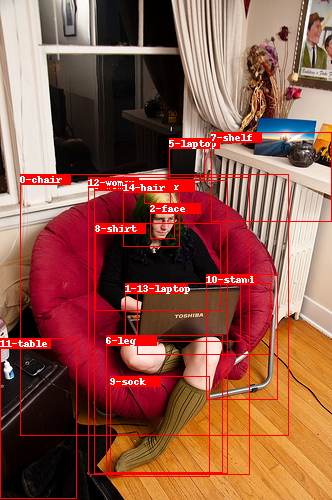

**************************************************
gt_boxes 0: 0-chair
gt_boxes 1: 1-laptop
gt_boxes 2: 2-face
gt_boxes 3: 3-woman
gt_boxes 4: 4-hair
gt_boxes 5: 5-laptop
gt_boxes 6: 6-leg
gt_boxes 7: 7-shelf
gt_boxes 8: 8-shirt
gt_boxes 9: 9-sock
gt_boxes 10: 10-stand
gt_boxes 11: 11-table
gt_boxes 12: 12-woman
gt_boxes 13: 13-laptop
gt_boxes 14: 14-hair
**************************************************
gt_rels 0: ('3-woman', 'sitting on', '0-chair')
gt_rels 1: ('2-face', 'on', '3-woman')
gt_rels 2: ('6-leg', 'on', '3-woman')
gt_rels 3: ('9-sock', 'on', '6-leg')
gt_rels 4: ('1-laptop', 'on', '3-woman')
gt_rels 5: ('5-laptop', 'on', '3-woman')
gt_rels 6: ('3-woman', 'on', '0-chair')
gt_rels 7: ('3-woman', 'wearing', '8-shirt')
gt_rels 8: ('12-woman', 'on', '0-chair')
gt_rels 9: ('4-hair', 'on', '3-woman')
gt_rels 10: ('3-woman', 'with', '14-hair')
**************************************************
pred_rels 0: ('13-laptop', 'on', '10-stand')
pred_rels 1: ('3-woman', 'has', '6-leg')
pr

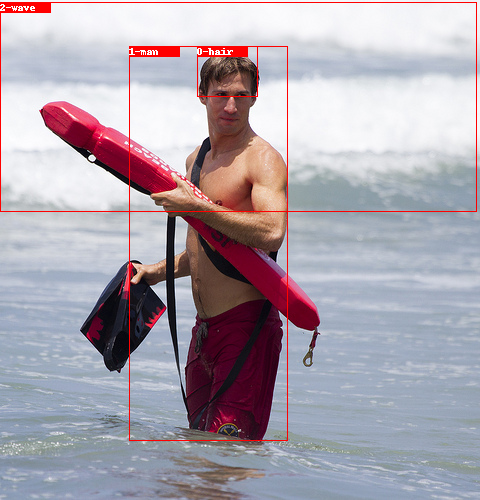

**************************************************
gt_boxes 0: 0-hair
gt_boxes 1: 1-man
gt_boxes 2: 2-wave
**************************************************
gt_rels 0: ('1-man', 'has', '0-hair')
gt_rels 1: ('1-man', 'has', '0-hair')
gt_rels 2: ('1-man', 'has', '0-hair')
gt_rels 3: ('1-man', 'has', '0-hair')
**************************************************
pred_rels 0: ('1-man', 'has', '0-hair')
pred_rels 1: ('2-wave', 'behind', '1-man')
pred_rels 2: ('0-hair', 'on', '1-man')
pred_rels 3: ('1-man', 'riding', '2-wave')
pred_rels 4: ('2-wave', 'has', '0-hair')
pred_rels 5: ('0-hair', 'of', '2-wave')
**************************************************
40


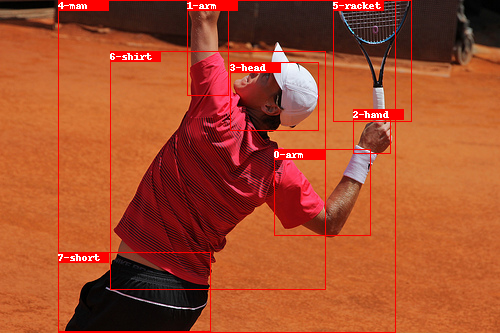

**************************************************
gt_boxes 0: 0-arm
gt_boxes 1: 1-arm
gt_boxes 2: 2-hand
gt_boxes 3: 3-head
gt_boxes 4: 4-man
gt_boxes 5: 5-racket
gt_boxes 6: 6-shirt
gt_boxes 7: 7-short
**************************************************
gt_rels 0: ('4-man', 'has', '1-arm')
gt_rels 1: ('4-man', 'has', '2-hand')
gt_rels 2: ('2-hand', 'on', '5-racket')
gt_rels 3: ('4-man', 'has', '3-head')
gt_rels 4: ('4-man', 'has', '0-arm')
gt_rels 5: ('4-man', 'has', '1-arm')
gt_rels 6: ('4-man', 'has', '0-arm')
gt_rels 7: ('4-man', 'has', '1-arm')
gt_rels 8: ('4-man', 'has', '3-head')
gt_rels 9: ('4-man', 'has', '6-shirt')
gt_rels 10: ('4-man', 'has', '7-short')
gt_rels 11: ('6-shirt', 'on', '4-man')
gt_rels 12: ('7-short', 'on', '4-man')
**************************************************
pred_rels 0: ('4-man', 'holding', '5-racket')
pred_rels 1: ('4-man', 'wearing', '7-short')
pred_rels 2: ('4-man', 'wearing', '6-shirt')
pred_rels 3: ('0-arm', 'of', '4-man')
pred_rels 4: ('3-head', 

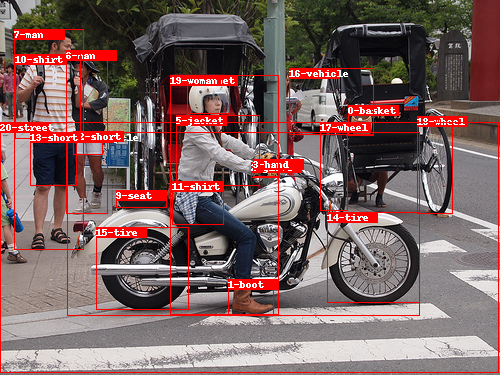

**************************************************
gt_boxes 0: 0-basket
gt_boxes 1: 1-boot
gt_boxes 2: 2-glove
gt_boxes 3: 3-hand
gt_boxes 4: 4-helmet
gt_boxes 5: 5-jacket
gt_boxes 6: 6-man
gt_boxes 7: 7-man
gt_boxes 8: 8-motorcycle
gt_boxes 9: 9-seat
gt_boxes 10: 10-shirt
gt_boxes 11: 11-shirt
gt_boxes 12: 12-short
gt_boxes 13: 13-short
gt_boxes 14: 14-tire
gt_boxes 15: 15-tire
gt_boxes 16: 16-vehicle
gt_boxes 17: 17-wheel
gt_boxes 18: 18-wheel
gt_boxes 19: 19-woman
gt_boxes 20: 20-street
**************************************************
gt_rels 0: ('19-woman', 'above', '8-motorcycle')
gt_rels 1: ('19-woman', 'wearing', '4-helmet')
gt_rels 2: ('19-woman', 'wearing', '2-glove')
gt_rels 3: ('8-motorcycle', 'has', '14-tire')
gt_rels 4: ('8-motorcycle', 'has', '15-tire')
gt_rels 5: ('19-woman', 'above', '8-motorcycle')
gt_rels 6: ('19-woman', 'has', '5-jacket')
gt_rels 7: ('6-man', 'wearing', '12-short')
gt_rels 8: ('16-vehicle', 'above', '20-street')
gt_rels 9: ('19-woman', 'wearing', '

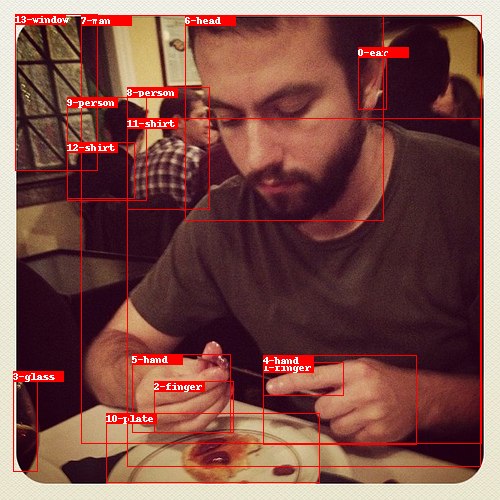

**************************************************
gt_boxes 0: 0-ear
gt_boxes 1: 1-finger
gt_boxes 2: 2-finger
gt_boxes 3: 3-glass
gt_boxes 4: 4-hand
gt_boxes 5: 5-hand
gt_boxes 6: 6-head
gt_boxes 7: 7-man
gt_boxes 8: 8-person
gt_boxes 9: 9-person
gt_boxes 10: 10-plate
gt_boxes 11: 11-shirt
gt_boxes 12: 12-shirt
gt_boxes 13: 13-window
**************************************************
gt_rels 0: ('7-man', 'wearing', '11-shirt')
gt_rels 1: ('7-man', 'has', '6-head')
gt_rels 2: ('4-hand', 'has', '1-finger')
gt_rels 3: ('5-hand', 'has', '2-finger')
gt_rels 4: ('7-man', 'has', '0-ear')
gt_rels 5: ('7-man', 'wearing', '11-shirt')
gt_rels 6: ('9-person', 'in', '12-shirt')
**************************************************
pred_rels 0: ('7-man', 'wearing', '11-shirt')
pred_rels 1: ('9-person', 'wearing', '12-shirt')
pred_rels 2: ('7-man', 'has', '0-ear')
pred_rels 3: ('7-man', 'has', '6-head')
pred_rels 4: ('0-ear', 'of', '7-man')
pred_rels 5: ('1-finger', 'on', '4-hand')
pred_rels 6: ('7-man

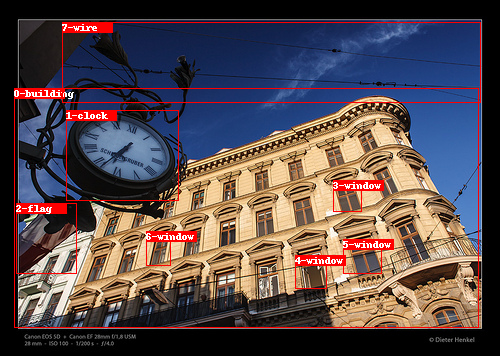

**************************************************
gt_boxes 0: 0-building
gt_boxes 1: 1-clock
gt_boxes 2: 2-flag
gt_boxes 3: 3-window
gt_boxes 4: 4-window
gt_boxes 5: 5-window
gt_boxes 6: 6-window
gt_boxes 7: 7-wire
**************************************************
gt_rels 0: ('5-window', 'on', '0-building')
gt_rels 1: ('3-window', 'on', '0-building')
gt_rels 2: ('6-window', 'on', '0-building')
gt_rels 3: ('3-window', 'on', '0-building')
gt_rels 4: ('5-window', 'on', '0-building')
**************************************************
pred_rels 0: ('1-clock', 'on', '0-building')
pred_rels 1: ('3-window', 'on', '0-building')
pred_rels 2: ('5-window', 'on', '0-building')
pred_rels 3: ('6-window', 'on', '0-building')
pred_rels 4: ('4-window', 'on', '0-building')
pred_rels 5: ('7-wire', 'above', '0-building')
pred_rels 6: ('2-flag', 'on', '0-building')
pred_rels 7: ('0-building', 'has', '5-window')
pred_rels 8: ('0-building', 'has', '4-window')
pred_rels 9: ('0-building', 'has', '3-window')
p

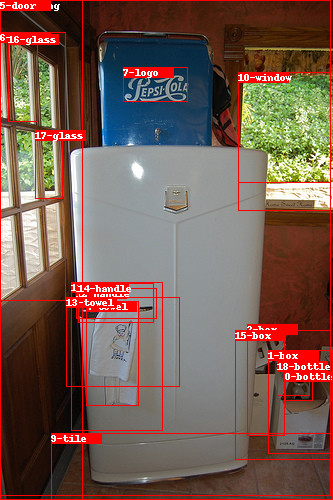

**************************************************
gt_boxes 0: 0-bottle
gt_boxes 1: 1-box
gt_boxes 2: 2-box
gt_boxes 3: 3-building
gt_boxes 4: 4-towel
gt_boxes 5: 5-door
gt_boxes 6: 6-window
gt_boxes 7: 7-logo
gt_boxes 8: 8-plant
gt_boxes 9: 9-tile
gt_boxes 10: 10-window
gt_boxes 11: 11-towel
gt_boxes 12: 12-handle
gt_boxes 13: 13-towel
gt_boxes 14: 14-handle
gt_boxes 15: 15-box
gt_boxes 16: 16-glass
gt_boxes 17: 17-glass
gt_boxes 18: 18-bottle
**************************************************
gt_rels 0: ('1-box', 'with', '0-bottle')
gt_rels 1: ('11-towel', 'on', '12-handle')
gt_rels 2: ('11-towel', 'on', '12-handle')
gt_rels 3: ('11-towel', 'on', '14-handle')
gt_rels 4: ('11-towel', 'on', '12-handle')
gt_rels 5: ('0-bottle', 'on', '1-box')
gt_rels 6: ('5-door', 'with', '16-glass')
gt_rels 7: ('5-door', 'with', '6-window')
gt_rels 8: ('5-door', 'with', '6-window')
gt_rels 9: ('5-door', 'with', '17-glass')
gt_rels 10: ('5-door', 'with', '6-window')
gt_rels 11: ('6-window', 'with', '16-

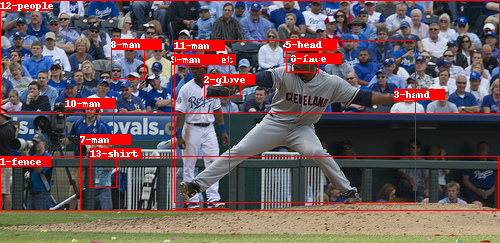

**************************************************
gt_boxes 0: 0-face
gt_boxes 1: 1-fence
gt_boxes 2: 2-glove
gt_boxes 3: 3-hand
gt_boxes 4: 4-hat
gt_boxes 5: 5-head
gt_boxes 6: 6-helmet
gt_boxes 7: 7-man
gt_boxes 8: 8-man
gt_boxes 9: 9-man
gt_boxes 10: 10-man
gt_boxes 11: 11-man
gt_boxes 12: 12-people
gt_boxes 13: 13-shirt
**************************************************
gt_rels 0: ('7-man', 'in', '13-shirt')
gt_rels 1: ('5-head', 'of', '11-man')
gt_rels 2: ('0-face', 'of', '11-man')
gt_rels 3: ('8-man', 'in', '12-people')
gt_rels 4: ('3-hand', 'of', '11-man')
gt_rels 5: ('4-hat', 'on', '11-man')
gt_rels 6: ('2-glove', 'on', '11-man')
gt_rels 7: ('9-man', 'on', '1-fence')
gt_rels 8: ('1-fence', 'behind', '9-man')
gt_rels 9: ('9-man', 'on', '1-fence')
gt_rels 10: ('2-glove', 'on', '11-man')
**************************************************
pred_rels 0: ('4-hat', 'on', '5-head')
pred_rels 1: ('7-man', 'wearing', '13-shirt')
pred_rels 2: ('11-man', 'wearing', '4-hat')
pred_rels 3: ('9

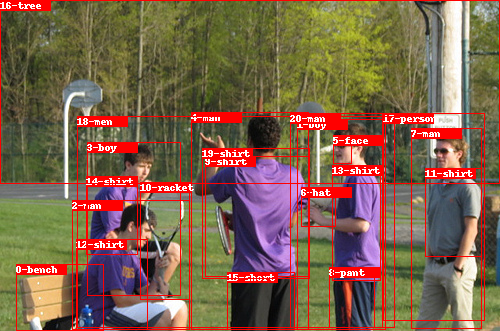

**************************************************
gt_boxes 0: 0-bench
gt_boxes 1: 1-boy
gt_boxes 2: 2-man
gt_boxes 3: 3-boy
gt_boxes 4: 4-man
gt_boxes 5: 5-face
gt_boxes 6: 6-hat
gt_boxes 7: 7-man
gt_boxes 8: 8-pant
gt_boxes 9: 9-shirt
gt_boxes 10: 10-racket
gt_boxes 11: 11-shirt
gt_boxes 12: 12-shirt
gt_boxes 13: 13-shirt
gt_boxes 14: 14-shirt
gt_boxes 15: 15-short
gt_boxes 16: 16-tree
gt_boxes 17: 17-person
gt_boxes 18: 18-men
gt_boxes 19: 19-shirt
gt_boxes 20: 20-man
**************************************************
gt_rels 0: ('18-men', 'wearing', '13-shirt')
gt_rels 1: ('18-men', 'wearing', '19-shirt')
gt_rels 2: ('18-men', 'wearing', '12-shirt')
gt_rels 3: ('18-men', 'wearing', '14-shirt')
gt_rels 4: ('7-man', 'wearing', '11-shirt')
gt_rels 5: ('4-man', 'wearing', '9-shirt')
gt_rels 6: ('4-man', 'wearing', '19-shirt')
gt_rels 7: ('2-man', 'on', '0-bench')
gt_rels 8: ('4-man', 'wears', '15-short')
gt_rels 9: ('4-man', 'wearing', '9-shirt')
gt_rels 10: ('2-man', 'holding', '10-ra

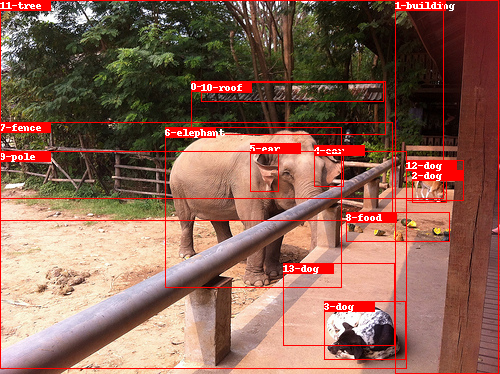

**************************************************
gt_boxes 0: 0-building
gt_boxes 1: 1-building
gt_boxes 2: 2-dog
gt_boxes 3: 3-dog
gt_boxes 4: 4-ear
gt_boxes 5: 5-ear
gt_boxes 6: 6-elephant
gt_boxes 7: 7-fence
gt_boxes 8: 8-food
gt_boxes 9: 9-pole
gt_boxes 10: 10-roof
gt_boxes 11: 11-tree
gt_boxes 12: 12-dog
gt_boxes 13: 13-dog
**************************************************
gt_rels 0: ('10-roof', 'under', '11-tree')
gt_rels 1: ('7-fence', 'in front of', '11-tree')
gt_rels 2: ('5-ear', 'of', '6-elephant')
gt_rels 3: ('4-ear', 'of', '6-elephant')
gt_rels 4: ('6-elephant', 'in', '9-pole')
gt_rels 5: ('0-building', 'with', '10-roof')
gt_rels 6: ('1-building', 'with', '10-roof')
gt_rels 7: ('7-fence', 'along', '9-pole')
gt_rels 8: ('7-fence', 'behind', '6-elephant')
**************************************************
pred_rels 0: ('11-tree', 'behind', '7-fence')
pred_rels 1: ('6-elephant', 'has', '5-ear')
pred_rels 2: ('10-roof', 'on', '0-building')
pred_rels 3: ('6-elephant', 'has', '

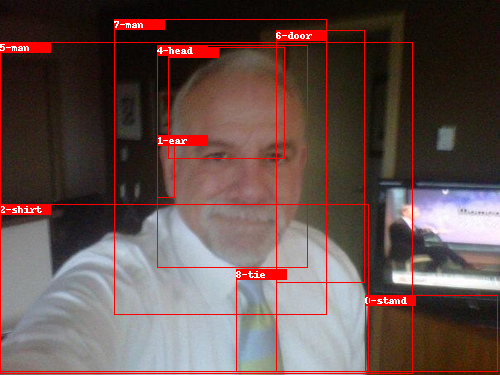

**************************************************
gt_boxes 0: 0-stand
gt_boxes 1: 1-ear
gt_boxes 2: 2-shirt
gt_boxes 3: 3-hair
gt_boxes 4: 4-head
gt_boxes 5: 5-man
gt_boxes 6: 6-door
gt_boxes 7: 7-man
gt_boxes 8: 8-tie
**************************************************
gt_rels 0: ('5-man', 'wearing', '2-shirt')
gt_rels 1: ('5-man', 'wearing', '2-shirt')
gt_rels 2: ('3-hair', 'of', '5-man')
gt_rels 3: ('1-ear', 'of', '5-man')
gt_rels 4: ('5-man', 'wearing', '2-shirt')
gt_rels 5: ('5-man', 'wearing', '8-tie')
gt_rels 6: ('4-head', 'of', '5-man')
**************************************************
pred_rels 0: ('5-man', 'wearing', '8-tie')
pred_rels 1: ('5-man', 'wearing', '2-shirt')
pred_rels 2: ('3-hair', 'on', '4-head')
pred_rels 3: ('5-man', 'has', '3-hair')
pred_rels 4: ('1-ear', 'of', '5-man')
pred_rels 5: ('5-man', 'has', '1-ear')
pred_rels 6: ('5-man', 'has', '4-head')
pred_rels 7: ('4-head', 'of', '5-man')
pred_rels 8: ('6-door', 'behind', '5-man')
pred_rels 9: ('1-ear', 'on', '4

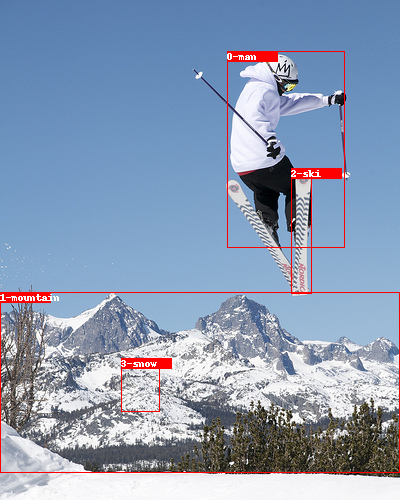

**************************************************
gt_boxes 0: 0-man
gt_boxes 1: 1-mountain
gt_boxes 2: 2-ski
gt_boxes 3: 3-snow
**************************************************
gt_rels 0: ('0-man', 'on', '2-ski')
gt_rels 1: ('0-man', 'on', '2-ski')
gt_rels 2: ('0-man', 'on', '2-ski')
gt_rels 3: ('3-snow', 'on', '1-mountain')
gt_rels 4: ('3-snow', 'on', '1-mountain')
gt_rels 5: ('0-man', 'on', '2-ski')
gt_rels 6: ('0-man', 'on', '2-ski')
gt_rels 7: ('0-man', 'on', '2-ski')
gt_rels 8: ('0-man', 'on', '2-ski')
gt_rels 9: ('0-man', 'on', '2-ski')
gt_rels 10: ('0-man', 'on', '2-ski')
gt_rels 11: ('0-man', 'on', '2-ski')
gt_rels 12: ('0-man', 'in', '3-snow')
gt_rels 13: ('0-man', 'in', '3-snow')
gt_rels 14: ('0-man', 'in', '3-snow')
gt_rels 15: ('0-man', 'in', '3-snow')
gt_rels 16: ('3-snow', 'on', '1-mountain')
**************************************************
pred_rels 0: ('1-mountain', 'behind', '0-man')
pred_rels 1: ('3-snow', 'on', '1-mountain')
pred_rels 2: ('0-man', 'on', '2-ski')

In [13]:
show_all(start_idx=0, length=50)
#show_selected([119, 967, 713, 5224, 19681, 25371])